<a href="https://colab.research.google.com/github/TOPMANZA/yolov5_Project/blob/main/YOLOv5_Custom_Training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.activity.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fexperimentsandconfigs%20https%3a%2f%2fwww.googleapis.com%2fauth%2fphotos.native&response_type=code

Enter your authorization code:
4/1AX4XfWiVymMNgKKXfa1WdamFKx3V9yWdkxMAHqZMYFnR1Hg03lD4Lug3jak
Mounted at /content/drive


In [ ]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 9915, done.
remote: Counting objects: 100% (74/74), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 9915 (delta 73), reused 71 (delta 71), pack-reused 9841
Receiving objects: 100% (9915/9915), 10.06 MiB | 17.43 MiB/s, done.
Resolving deltas: 100% (6905/6905), done.
/content/yolov5
     |████████████████████████████████| 596 kB 12.9 MB/s 
     |████████████████████████████████| 178 kB 13.7 MB/s 
     |████████████████████████████████| 1.1 MB 53.0 MB/s 
     |████████████████████████████████| 138 kB 54.1 MB/s 
     |████████████████████████████████| 62 kB 824 kB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.26.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incomp

In [ ]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="xfnLqQcShMCF4bosVIkh")
project = rf.workspace().project("elderly-face-detection2")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/elderly-face-detection2-1 in yolov5pytorch:: 100%|██████████| 1676/1676 [00:02<00:00, 727.45it/s]


In [ ]:
print({dataset.location})

{'/content/datasets/elderly-face-detection2-2'}



- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [ ]:
!python train.py --img 640 --batch 26 --epochs 999 --data {dataset.location}/data.yaml --weights yolov5s.pt --device 0
# !python train.py --resume


train: weights=yolov5s.pt, cfg=, data=/content/datasets/elderly-face-detection2-1/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=999, batch_size=26, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=0, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-31-g3d89798 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 851), started 1:42:03 ago. (Use '!kill 851' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!python val.py --weights runs/train/exp/weights/best.pt --img 640 --data {dataset}/data.yaml

val: data=/content/datasets/elderly-face-detection2-1/data.yaml, weights=['runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, task=val, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False
YOLOv5 🚀 v6.0-30-gfee83c1 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 213 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning '/content/datasets/elderly-face-detection2-1/valid/labels.cache' images and labels... 208 found, 0 missing, 0 empty, 0 corrupted: 100% 208/208 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 7/7 [00:04<00:00,  1.45it/s]
                 all        208        208      0.936       0.91      0.937      0.544
             Elderly        208        104      0.872      0.856      0.883     

In [ ]:
dataset = '/content/datasets/elderly-face-detection2-1'
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.1 --source {dataset}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/elderly-face-detection2-1/test/images, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-30-gfee83c1 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 213 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/208 /content/datasets/elderly-face-detection2-1/test/images/ep111_jpg.rf.5cccf36f4b6d4717548827b3b61bc075.jpg: 640x640 1 Elderly, Done. (0.007s)
image 2/208 /content/datasets/elderly-face-detection2-1/test/images/ep112_jpg.rf.caa1a4544ad341819de17c7682d6814a.jpg: 640x640 1 Elderly, Done. (0.007s)
image 3/208 /content/datasets/elderly-face-d

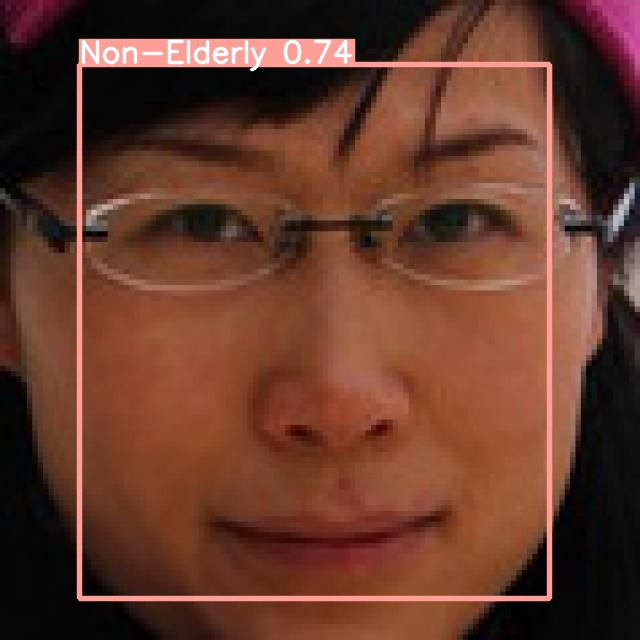

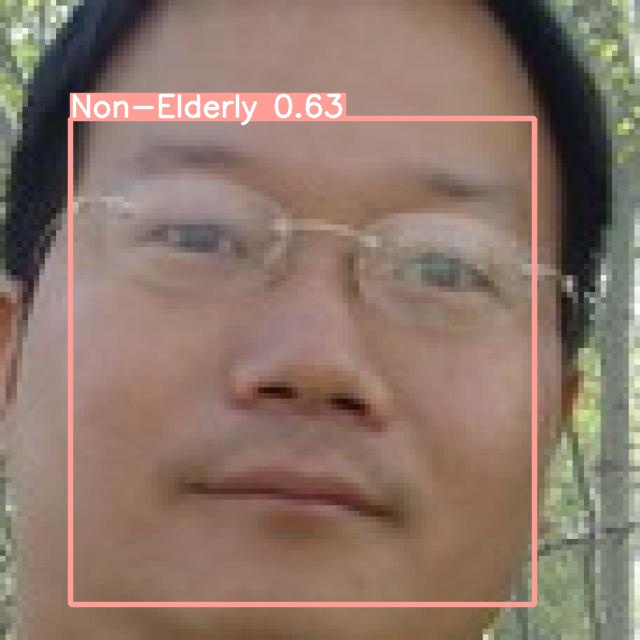

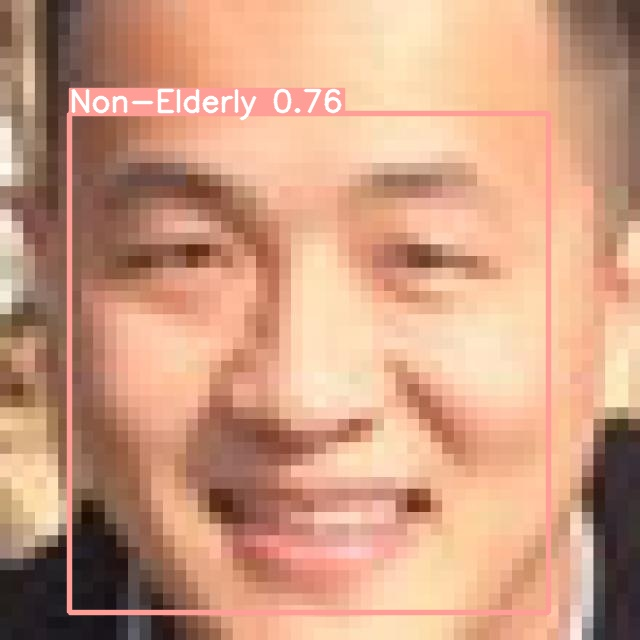

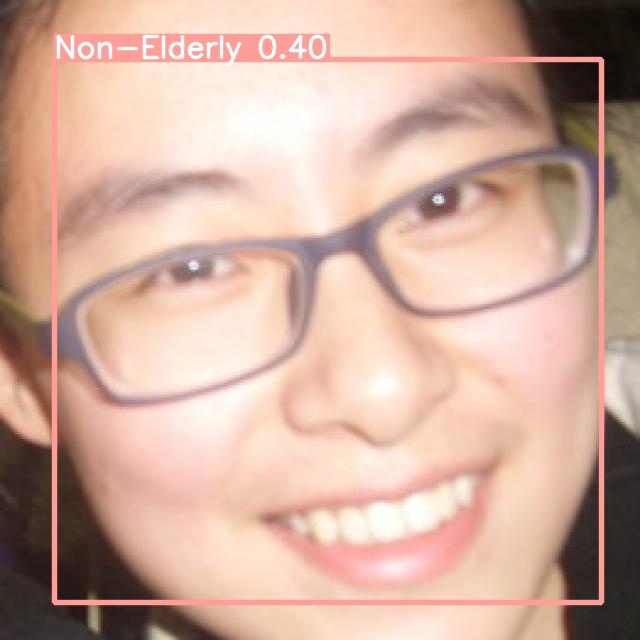

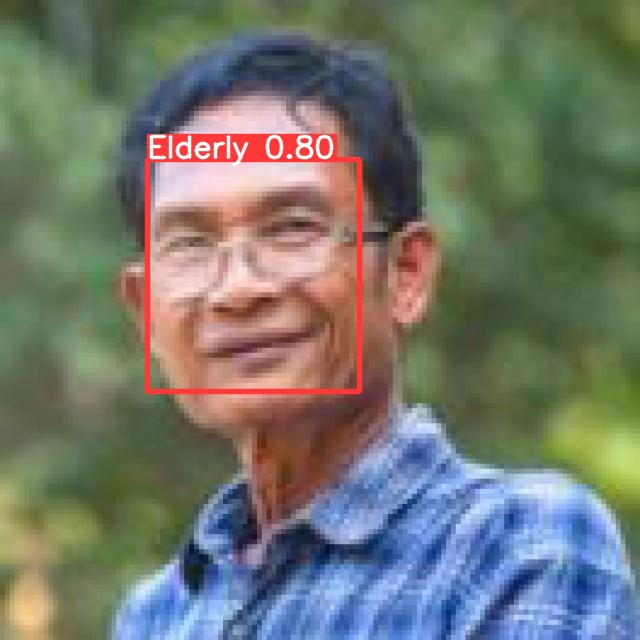

...

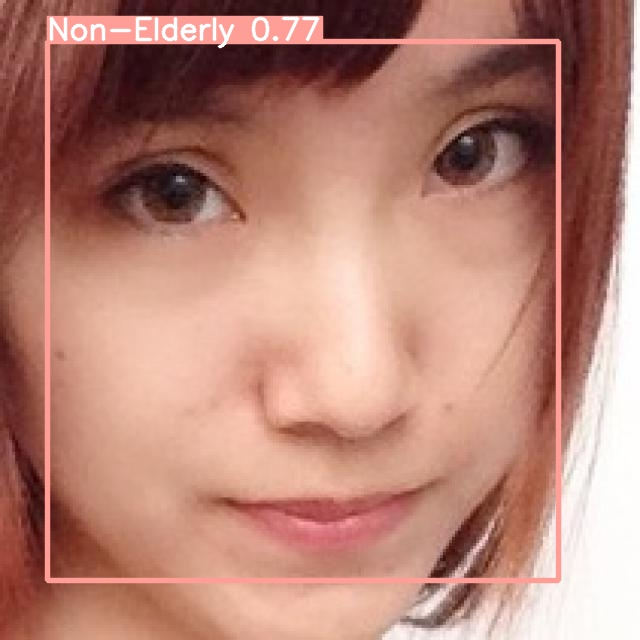

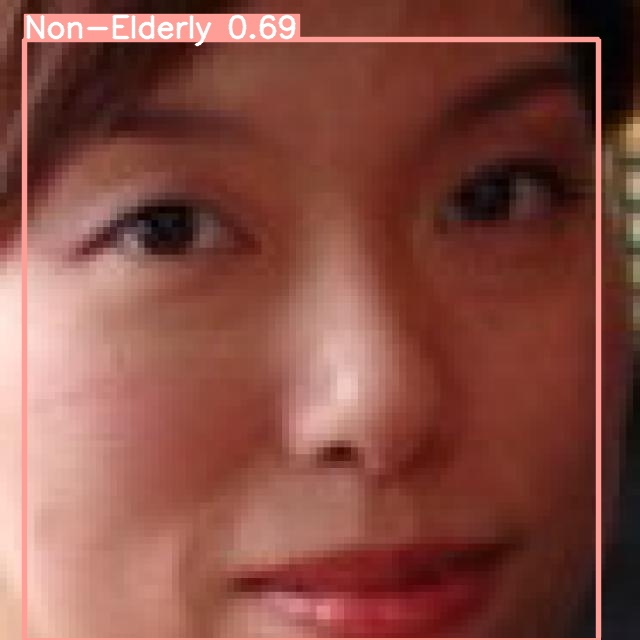

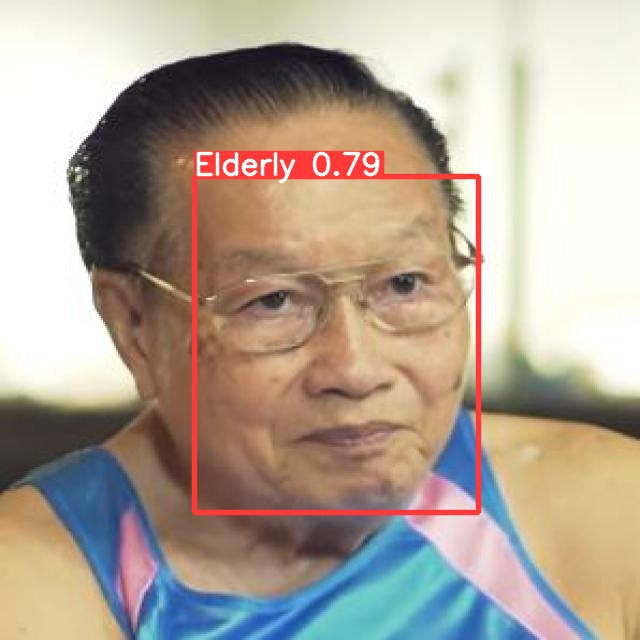

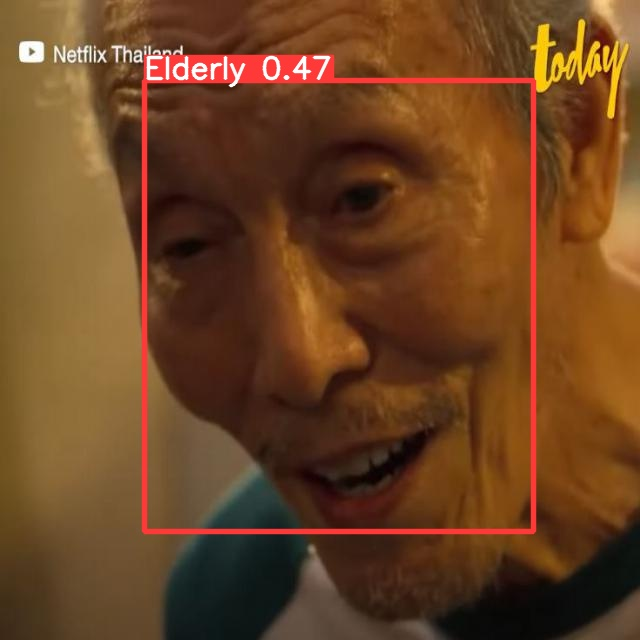

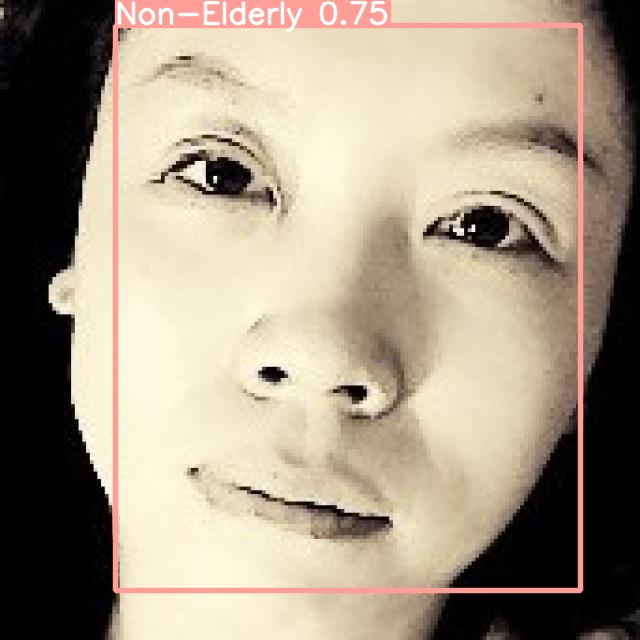

In [ ]:
 #display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/yolov5/runs/detect/exp6/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Conclusion and Next Steps

Congratulations! You've trained a custom YOLOv5 model to recognize your custom objects.

To improve you model's performance, we recommend first interating on your datasets coverage and quality. See this guide for [model performance improvement](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results).

To deploy your model to an application, see this guide on [exporting your model to deployment destinations](https://github.com/ultralytics/yolov5/issues/251).

Once your model is in production, you will want to continually iterate and improve on your dataset and model via [active learning](https://blog.roboflow.com/what-is-active-learning/).

In [ ]:
#export your model's weights for future use
from google.colab import files
files.download('/content/yolov5.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!zip -r /content/yolov5.zip /content/yolov5

  adding: content/yolov5/ (stored 0%)
  adding: content/yolov5/yolov5s.pt (deflated 8%)
  adding: content/yolov5/data/ (stored 0%)
  adding: content/yolov5/data/SKU-110K.yaml (deflated 53%)
  adding: content/yolov5/data/images/ (stored 0%)
  adding: content/yolov5/data/images/bus.jpg (deflated 1%)
  adding: content/yolov5/data/images/zidane.jpg (deflated 0%)
  adding: content/yolov5/data/Argoverse.yaml (deflated 56%)
  adding: content/yolov5/data/GlobalWheat2020.yaml (deflated 55%)
  adding: content/yolov5/data/VOC.yaml (deflated 56%)
  adding: content/yolov5/data/coco128.yaml (deflated 50%)
  adding: content/yolov5/data/scripts/ (stored 0%)
  adding: content/yolov5/data/scripts/get_coco128.sh (deflated 36%)
  adding: content/yolov5/data/scripts/download_weights.sh (deflated 37%)
  adding: content/yolov5/data/scripts/get_coco.sh (deflated 47%)
  adding: content/yolov5/data/hyps/ (stored 0%)
  adding: content/yolov5/data/hyps/hyp.scratch-low.yaml (deflated 54%)
  adding: content/yolov5/